# Prerequisite

## Installing Libraries

In [ ]:
!pip install -q scikit-learn==1.4.1.post1 numpy pandas altair

# Linear Model: Normal Equation

## Case #1: Ideal Data


다음과 같은 선형 모델이 나올 수 있는 임의의 데이터를 생성해보자:
$y = \theta_0 + \theta_1 x = 4 + 3x $

In [ ]:
import numpy as np
import pandas as pd
import altair as alt


gen = np.random.default_rng(42)
X = gen.random(size=(100, 1)) * 2
y = 4 + 3 * X
data = pd.DataFrame(dict(x = np.ravel(X), y = np.ravel(y)))

alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y:Q')
)

alt.Chart(...)

In [ ]:
from sklearn.preprocessing import add_dummy_feature


X_b = add_dummy_feature(X) # Bias를 위한 Dummy 필드 (1)을 추가
X_b[:5]

array([[1.        , 1.5479121 ],
       [1.        , 0.87775688],
       [1.        , 1.71719584],
       [1.        , 1.39473606],
       [1.        , 0.1883547 ]])

\begin{align}
J(\Theta) &= \frac{1}{n}(\mathbf{X}\Theta - \mathbf{y})^\intercal (\mathbf{X} \Theta - \mathbf{y}) \\
\frac{d J(\Theta)}{d \Theta} & = \frac{2}{n}(\mathbf{X}^\intercal \mathbf{X}\Theta  - \mathbf{X}^\intercal \mathbf{y}) = 0 \\
\therefore & \quad \mathbf{X}^\intercal \mathbf{X} \hat{\Theta}  = \mathbf{X} ^\intercal \mathbf{y} \quad \Rightarrow \quad \hat{\Theta} = (\mathbf{X}^\intercal \mathbf{X})^{-1}\mathbf{X} ^\intercal \mathbf{y}
\end{align}

위의 정규 방정식대로 계산해보자.

In [ ]:
import numpy as np


np.linalg.inv(X_b.T @ X_b) @ X_b.T @ y

array([[4.],
       [3.]])

정확하게 $\theta_0 = 4$, $\theta_1=3$이 나오는 걸 확인할 수 있다.

## Case #2: With Noise
이번에는 다소 노이즈를 줘보자.

In [ ]:
import numpy as np
import pandas as pd
import altair as alt


gen = np.random.default_rng(42)
X = gen.random(size=(100, 1)) * 2
y = 4 + 3 * X + gen.random(size=(100, 1))
data = pd.DataFrame(dict(x = np.ravel(X), y = np.ravel(y)))

alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y:Q')
)

alt.Chart(...)

In [ ]:
from sklearn.preprocessing import add_dummy_feature
import numpy as np


X_b = add_dummy_feature(X)
theta = np.linalg.inv(X_b.T @ X_b) @ X_b.T @ y
theta

array([[4.57201738],
       [2.92706591]])

다음과 같이 그래프를 그려보면, 제대로 매개변수를 학습한 것 같다.

In [ ]:
import pandas as pd


data = pd.DataFrame(dict(x = np.ravel(X), y_pred = np.ravel(X_b @ theta), y_true = np.ravel(y)))

p_point = alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y_true:Q')
)
p_line = alt.Chart(data).mark_line(color='red').encode(
    x = alt.X('x:Q'), y=alt.Y('y_pred:Q')
)

(p_point + p_line).resolve_scale(y='independent')

alt.LayerChart(...)

Scikit-learn의 선형 회귀 모델은 [sklearn.linear_model.LinearRegression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html)에서 활용할 수 있다.

In [ ]:
from sklearn.linear_model import LinearRegression


lin_reg = LinearRegression()
lin_reg.fit(X, y)
lin_reg.intercept_, lin_reg.coef_

(array([4.57201738]), array([[2.92706591]]))

정규 방정식을 쓴 것과 동일한 결과가 나오는 것을 확인할 수 있다.


# Gradient Descent
이번에는 경사 하강법을 활용해서 최적의 매개변수를 찾아보자

\begin{align}
\frac{d J(\Theta)}{d \Theta} = \frac{2}{n}(\mathbf{X}^\intercal \mathbf{X}\Theta  - \mathbf{X}^\intercal \mathbf{y})
\end{align}


## Batch Gradient Descent
Batch Gradient Descent는 매 에폭마다 매개변수를 업데이트한다


In [ ]:
import numpy as np
import pandas as pd
import altair as alt


eta = 0.01
epochs = 300
n = len(X_b)
gen = np.random.default_rng(42)
theta = gen.random(size=(2, 1)) # 초기 매개변수를 무작위로 초기화

history = []

for i in range(epochs):
    m = X_b @ theta - y
    loss = 1 / n * m.T @ m
    history.append((i, np.ravel(loss)[0], np.ravel(theta)[0], np.ravel(theta)[1]))
    gradients = 2 / n * (X_b.T @ X_b @ theta - X_b.T @ y)
    theta = theta - eta * gradients

history = pd.DataFrame(history, columns=['epoch', 'mse', 'theta_0', 'theta_1'])
print(theta)

p_mse = alt.Chart(history).mark_line().encode(
    x='epoch', y='mse'
)

p_theta = alt.Chart(history).mark_line().encode(
    x='theta_0', y='theta_1'
)
p_mse | p_theta


[[4.18584518]
 [3.26783619]]


alt.HConcatChart(...)

정규 방정식의 결과와 정확하게 일치하지는 않지만 굉장히 유사한 결과가 나왔다

학습률의 차이는 어떨까?

In [ ]:
import numpy as np
import pandas as pd
import altair as alt


etas = [0.01, 0.1, 0.5]
epochs = 500
n = len(X_b)

history = []

for eta in etas:
    gen = np.random.default_rng(42)
    theta = gen.random(size=(2, 1))
    for i in range(epochs):
        m = X_b @ theta - y
        loss = 1 / n * m.T @ m
        history.append((str(eta), i, np.ravel(loss)[0], np.ravel(theta)[0], np.ravel(theta)[1]))
        gradients = 2 / n * (X_b.T @ X_b @ theta - X_b.T @ y)
        theta = theta - eta * gradients
    print(f'Eta: {eta} / Theta_0: {np.ravel(theta)[0]} / Theta_1: {np.ravel(theta)[1]}')

history = pd.DataFrame(history, columns=['eta', 'epoch', 'mse', 'theta_0', 'theta_1'])

p_mse = alt.Chart(history).mark_line().encode(
    x='epoch', y='mse'
).facet(
    column='eta:N'
).resolve_scale(
    y='independent',
)

p_theta = alt.Chart(history).mark_line().encode(
    x='theta_0', y='theta_1'
).facet(
    column='eta:N'
).resolve_scale(
    x='independent',
    y='independent',
)

display(p_mse)
display(p_theta)

Eta: 0.01 / Theta_0: 4.35246746503867 / Theta_1: 3.120811903368297
Eta: 0.1 / Theta_0: 4.572016828288516 / Theta_1: 2.927066402638507
Eta: 0.5 / Theta_0: -5.836703787967783e+21 / Theta_1: -6.614061112562125e+21


alt.FacetChart(...)

alt.FacetChart(...)

학습률에 따라 학습되는 속도 (MSE가 감소하는 속도)도 다를 뿐더러, 학습 결과도 달라진다. 예를 들어, 너무 큰 학습률 ($\eta = 0.5$)을 설정할 때는 경사 하강법이 제대로 동작하지 않음을 알 수 있다.

## Stochastic Gradient Descent
Stochastic Gradient Descent는 매번 하나의 샘플을 무작위로 뽑은 후에 그에 대해서 매개변수를 업데이트 한다.


In [ ]:
import numpy as np
import pandas as pd
import altair as alt


etas = [0.01, 0.1, 0.2] # 학습률 = 0.5는 좋지 않으므로 다른 걸로 바꾸자
epochs = 500
n = len(X_b)

history = []

for eta in etas:
    gen = np.random.default_rng(42)
    theta = gen.random(size=(2, 1))
    for i in range(epochs):
        indices = gen.integers(low=0, high=n, size=(n, 1))
        for j in indices:
            m = X_b @ theta - y
            loss = 1 / n * m.T @ m
            history.append((str(eta), i, np.ravel(loss)[0], np.ravel(theta)[0], np.ravel(theta)[1]))
            xj, yj = X_b[j], y[j]
            gradients = 2 * (xj.T @ xj @ theta - xj.T @ yj)
            theta = theta - eta * gradients
    print(f'Eta: {eta} / Theta_0: {np.ravel(theta)[0]} / Theta_1: {np.ravel(theta)[1]}')

history = pd.DataFrame(history, columns=['eta', 'epoch', 'mse', 'theta_0', 'theta_1'])

p_mse = alt.Chart(history).mark_line().encode(
    x='epoch', y='mse'
).facet(
    column='eta:N'
).resolve_scale(
    y='independent',
)

p_theta = alt.Chart(history).mark_line().encode(
    x='theta_0', y='theta_1'
).facet(
    column='eta:N'
).resolve_scale(
    x='independent',
    y='independent',
)

display(p_mse)
display(p_theta)

Eta: 0.01 / Theta_0: 4.539205359721376 / Theta_1: 2.960908221758113
Eta: 0.1 / Theta_0: 4.531238998287228 / Theta_1: 2.879541679505672
Eta: 0.2 / Theta_0: 4.579775592102967 / Theta_1: 2.961751609494624


alt.FacetChart(...)

alt.FacetChart(...)

Batch Gradient Descent 보다 훨씬 적은 Epoch 수로 학습이 된 걸 알 수 있다. 하지만, Batch Gradient Descent 보다 업데이트 되는 매개변수의 안정성이 떨어진다.

Scikit-learn에서 Stochastic Gradient Descent는 [sklearn.linear_model.SGDRegressor](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.SGDRegressor.html) 에서 지원한다.

In [ ]:
from sklearn.linear_model import SGDRegressor


sgd_reg = SGDRegressor(
    max_iter=500, # 에폭수
    random_state=42, # 랜덤 시드
    penalty=None, # L1, L2, ElasticNet 정규화 적용 여부
    eta0=0.01, # (초기) 학습률
    learning_rate='constant' # 학습률 스케쥴링; 'constant'의 경우 eta0를 계속 활용
).fit(
    X, y.ravel()
)
sgd_reg.intercept_, sgd_reg.coef_

(array([4.49147834]), array([2.98633995]))

보다 세부적인 초매개변수 내용은 API 문서를 참조할 것.

## Mini-batch Gradient Descent

Mini-batch Gradient Descent는 Mini-batch 만큼의 샘플에 대해 매개변수를 업데이트 한다.

In [ ]:
import numpy as np
import pandas as pd
import altair as alt
from itertools import product


eta = 0.01
minibatches = [4, 8, 16]
epochs = 500
n = len(X_b)

history = []

for minibatch in minibatches:
    gen = np.random.default_rng(42)
    theta = gen.random(size=(2, 1))
    for i in range(epochs):
        indices = gen.permutation(n)
        for j in range(0, n, minibatch):
            m = X_b @ theta - y
            loss = 1 / n * m.T @ m
            history.append((str(minibatch), i, np.ravel(loss)[0], np.ravel(theta)[0], np.ravel(theta)[1]))
            k = indices[j:j+minibatch]
            xj, yj = X_b[k], y[k]
            gradients = 2 * (xj.T @ xj @ theta - xj.T @ yj)
            theta = theta - eta * gradients
    print(f'Eta: {eta} / Theta_0: {np.ravel(theta)[0]} / Theta_1: {np.ravel(theta)[1]}')

history = pd.DataFrame(history, columns=['minibatch', 'epoch', 'mse', 'theta_0', 'theta_1'])

p_mse = alt.Chart(history).mark_line().encode(
    x='epoch', y='mse'
).facet(
    column='minibatch:N'
).resolve_scale(
    y='independent',
)

p_theta = alt.Chart(history).mark_line().encode(
    x='theta_0', y='theta_1'
).facet(
    column='minibatch:N'
).resolve_scale(
    x='independent',
    y='independent',
)

display(p_mse)
display(p_theta)

Eta: 0.01 / Theta_0: 4.586533458231023 / Theta_1: 2.9423019351265887
Eta: 0.01 / Theta_0: 4.587942662587641 / Theta_1: 2.946805192747775
Eta: 0.01 / Theta_0: 4.588291147724525 / Theta_1: 2.9468067521707533


alt.FacetChart(...)

alt.FacetChart(...)

Stochastic Gradient Descent 보다 훨씬 안정적이고, Batch Gradient Descent보다 더 적은 Epoch으로 학습이 된 것을 알 수 있다.

# Regularization

정규화의 효과를 알기 위해서 지저분한 데이터를 생성해보자

In [ ]:
import numpy as np
import pandas as pd
import altair as alt


gen = np.random.default_rng(42)
X = gen.random(size=(20, 1)) * 2
y = 5 + 1.5 * X + gen.random(size=(20, 1)) * 10
data = pd.DataFrame(dict(x = np.ravel(X), y = np.ravel(y)))

alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y:Q')
)

alt.Chart(...)

이 데이터가 의미하는 바는 명확하다: 기울기(Slope)보다 편차(Bias)가 더 중요하다는 것(1.5 vs. 5 + $\epsilon$).

## Lasso Regression
L1-Norm을 규제항으로 사용하는 회귀모델로, 희소모델을 만들 수 있다.
Scikit-learn에서는 간단하게 [sklearn.linear_model.Lasso](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html#sklearn.linear_model.Lasso)를 활용하면 된다.

In [ ]:
from sklearn.linear_model import Lasso
import pandas as pd
import altair as alt


alphas = [0.25, 0.5, 0.75, 1.0]
results = []

for alpha in alphas:
    model = Lasso(
        alpha=alpha # 규제 강도
    ).fit(
        X, np.ravel(y)
    )
    result = pd.DataFrame(dict(alpha=alpha, x = np.ravel(X), y=model.predict(X)))
    results.append(result)
    print(f'Alpha: {alpha} / Theta_0: {model.intercept_} / Theta_1: {model.coef_[0]}')

results = pd.concat(results, axis=0)


p_point = alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y:Q')
)
p_line = alt.Chart(results).mark_line().encode(
    x='x', y='y', color=alt.Color('alpha:N', scale=alt.Scale(scheme = 'viridis'))
)

(p_point + p_line).interactive()

Alpha: 0.25 / Theta_0: 10.237340262621391 / Theta_1: 1.2353678617543344
Alpha: 0.5 / Theta_0: 11.170001876389348 / Theta_1: 0.4227214459805951
Alpha: 0.75 / Theta_0: 11.655152685314293 / Theta_1: 0.0
Alpha: 1.0 / Theta_0: 11.655152685314293 / Theta_1: 0.0


alt.LayerChart(...)

규제 강도 $\alpha$가 증가할수록 학습한 기울기, $\theta_1$,는 감소하고, 편차, $\theta_0$,는 증가한다는 것을 알 수 있다.
또한, $\alpha=0.75$ 일 때는 $\theta_1$이 0이 되면서 입력 $x$에 대한 영향은 사라진다.

## Ridge Regression
L2-Norm을 규제항으로 사용하는 Ridge Regression을 보자.
Scikit-learn에서는 [sklearn.linear_model.Ridge](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Ridge.html)를 활용하면 된다.

In [ ]:
from sklearn.linear_model import Ridge
import pandas as pd
import altair as alt


alphas = [0.25, 1.0, 10.0, 100.0]
results = []

for alpha in alphas:
    model = Ridge(
        alpha=alpha # 규제 강도
    ).fit(
        X, np.ravel(y)
    )
    result = pd.DataFrame(dict(alpha=alpha, x = np.ravel(X), y=model.predict(X)))
    results.append(result)
    print(f'Alpha: {alpha} / Theta_0: {model.intercept_} / Theta_1: {model.coef_[0]}')

results = pd.concat(results, axis=0)


p_point = alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y:Q')
)
p_line = alt.Chart(results).mark_line().encode(
    x='x', y='y', color=alt.Color('alpha:N', scale=alt.Scale(scheme = 'viridis'))
)

(p_point + p_line).interactive()

Alpha: 0.25 / Theta_0: 9.396454786445021 / Theta_1: 1.968047922993493
Alpha: 1.0 / Theta_0: 9.633290465996776 / Theta_1: 1.7616883352567188
Alpha: 10.0 / Theta_0: 10.759833881935176 / Theta_1: 0.7801088902988671
Alpha: 100.0 / Theta_0: 11.518916447993778 / Theta_1: 0.11870531425619696


alt.LayerChart(...)

Lasso와 마찬가지로 규제 강도 $\alpha$가 증가할수록 학습한 기울기, $\theta_1$,는 감소하고, 편차, $\theta_0$,는 증가한다는 것을 알 수 있다. 하지만, 규제 강도를 크게 높이더라도 Lasso처럼 매개변수의 값이 0이 되지는 않는다.

## ElasticNet
L1-Norm과 L2-Norm을 조합한 규제항을 사용하는 ElasticNet은, Scikit-learn에서 [sklearn.linear_model.ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html)을 활용하면 된다.

In [ ]:
from sklearn.linear_model import ElasticNet
import pandas as pd
import altair as alt


rhos = [0, 0.25, 0.5, 0.75, 1]
results = []

for rho in rhos:
    model = ElasticNet(
        alpha=0.2, # 규제 강도,
        l1_ratio=rho # L1 Norm의 활용 강도; 1 - l1_ratio가 L2 Norm의 강도가 된다.
    ).fit(
        X, np.ravel(y)
    )
    result = pd.DataFrame(dict(rho=rho, x = np.ravel(X), y=model.predict(X)))
    results.append(result)
    print(f'Rho: {rho} / Theta_0: {model.intercept_} / Theta_1: {model.coef_[0]}')

results = pd.concat(results, axis=0)


p_point = alt.Chart(data).mark_point(filled=True).encode(
    x = alt.X('x:Q'), y=alt.Y('y:Q')
)
p_line = alt.Chart(results).mark_line().encode(
    x='x', y='y', color=alt.Color('rho:N', scale=alt.Scale(scheme = 'viridis'))
)

(p_point + p_line).interactive()

Rho: 0 / Theta_0: 10.230724085672827 / Theta_1: 1.2411326669141105
Rho: 0.25 / Theta_0: 10.200487863679312 / Theta_1: 1.2674780820859657
Rho: 0.5 / Theta_0: 10.162834201263369 / Theta_1: 1.300286459048592
Rho: 0.75 / Theta_0: 10.114652076727303 / Theta_1: 1.3422684922218144
Rho: 1 / Theta_0: 10.050807939867799 / Theta_1: 1.3978971449090822


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.715e+01, tolerance: 1.899e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(


alt.LayerChart(...)

L1-Norm을 많이 활용할 수록 $\theta_1$이 감소하는 것을 알 수 있다.

# Logistic Regression

선형 모델의 결과값을 Sigmoid 함수에 넣은 값을 출력하며, 그 출력값은 확률로 해석할 수 있다.

\begin{align}
y & = \sigma (\mathbf{x}^\intercal \Theta) \\
& = \frac{1}{1 + e^{-\mathbf{x}^\intercal \Theta}}
\end{align}

보다 자세한 건 다음의 실습으로 확인해보자.

## Data Preparation

수많은 기계 학습 튜토리얼에서 사용되는 유명한 데이터셋, **Iris**, 를 써보자.

In [ ]:
from sklearn.datasets import load_iris


data = load_iris(as_frame=True)
X, y = data.data, data.target
print(data.DESCR)
display(X.head())
display(y.head())

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

    :Number of Instances: 150 (50 in each of three classes)
    :Number of Attributes: 4 numeric, predictive attributes and the class
    :Attribute Information:
        - sepal length in cm
        - sepal width in cm
        - petal length in cm
        - petal width in cm
        - class:
                - Iris-Setosa
                - Iris-Versicolour
                - Iris-Virginica
                
    :Summary Statistics:

    ============== ==== ==== ======= ===== ====================
                    Min  Max   Mean    SD   Class Correlation
    ============== ==== ==== ======= ===== ====================
    sepal length:   4.3  7.9   5.84   0.83    0.7826
    sepal width:    2.0  4.4   3.05   0.43   -0.4194
    petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
    petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
    ============== ==== ==== ======= ===== ===========

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


0    0
1    0
2    0
3    0
4    0
Name: target, dtype: int64

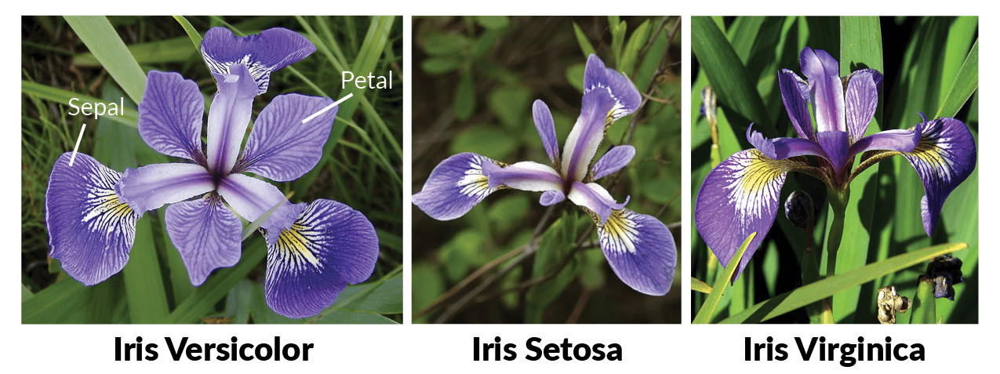

이 데이터의 목적은 꽃받침Sepal의 길이와 너비, 꽃잎Petal의 길이와 너비로 서로 다른 붓꽃Iris의 품종들Versicolor, Setosa, Virginica를  분류Classification 하는 것이다.

## One vs. Rest
일단, 우리가 수업시간에 배웠던 대로라면 Logistic Regression은 이진 분류Binary Classification에서 사용된다. 하지만, 이 데이터는 3개의 서로 다른 클래스 레이블(즉, 품종)을 가지고 있으니 직접적으로 사용될 수 없어보인다. 대신에, 이진 분류 모델 3개를 다음과 같이 만들면 어떨까?

* 모델1: Versicolor vs. Setosa, Virginica
* 모델2: Setosa vs. Versicolor, Virginica
* 모델3: Virginica vs. Versicolor, Virginica

Scikit-learn의 [sklearn.linear_model.LogisticRegression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html)을 활용해보자.

In [ ]:
from sklearn.linear_model import LogisticRegression


model1 = LogisticRegression(penalty=None, multi_class='ovr').fit(X, y == 0)
model2 = LogisticRegression(penalty=None, multi_class='ovr').fit(X, y == 1)
model3 = LogisticRegression(penalty=None, multi_class='ovr').fit(X, y == 2)

확률 출력값은 다음과 같이 낼 수 있다.

In [ ]:
import numpy as np


model1.predict_proba(X[:5])

array([[3.94190058e-09, 9.99999996e-01],
       [1.95436761e-07, 9.99999805e-01],
       [2.36898837e-08, 9.99999976e-01],
       [5.42770658e-07, 9.99999457e-01],
       [2.39641840e-09, 9.99999998e-01]])

출력값은 2차원 배열로 나온다. 무슨 의미일까? 다음을 실행해보자.

In [ ]:
model1.classes_

array([False,  True])

첫 번째 차원의 출력값은 레이블 값이 False (model1의 경우 실제 y값이 1 또는 2)일 때의 확률, 두 번째 차원의 출력값은 레이블 값이 True (model1 의 경우 실제 y 값이 0)일 때의 확률임을 의미한다. 이진 분류이기 때문에 True일 확률 = 1 - False일 확률과 동일하다.

그럼, 확률이 아니라 실제 레이블 값을 출력하려면 어떻게 해야할까? 다음의 코드를 실행해보자

In [ ]:
model1.predict(X)

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

위 코드는 어떤 기준에서 저런 레이블 값을 냈을까? 단순하다. 둘 중 확률값이 높은 레이블 값이 출력되는 것이다.

In [ ]:
import numpy as np


np.argmax(model1.predict_proba(X), axis=1) == 1

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

동일하게 나오는 것을 알 수 있다.




그럼, 세 모델에서 True라고 이야기하는 확률 결과만을 합쳐보자.



In [ ]:
import pandas as pd


result = pd.DataFrame(dict(
    versicolor=model1.predict_proba(X)[:, 1],
    setosa=model2.predict_proba(X)[:, 1],
    virginica=model3.predict_proba(X)[:, 1]
))
result.head()

,versicolor,setosa,virginica
0,1.000000,0.084913,1.544196e-27
1,1.000000,0.282918,7.137966e-26
2,1.000000,0.171983,1.196459e-26
3,0.999999,0.268015,1.968444e-25
4,1.000000,0.067075,1.013018e-27


확률이므로, 서로 다른 레이블에 대한 확률 출력값의 합은 1이 되어야 한다.

In [ ]:
result = result.assign(
    versicolor_norm=lambda x: x['versicolor'] / x.sum(axis=1),
    setosa_norm=lambda x: x['setosa'] / x.sum(axis=1),
    virginicar_norm=lambda x: x['virginica'] / x.sum(axis=1)
)
result.head()

,versicolor,setosa,virginica,versicolor_norm,setosa_norm,virginicar_norm
0,1.000000,0.084913,1.544196e-27,0.921732,0.042316,7.536479e-28
1,1.000000,0.282918,7.137966e-26,0.779473,0.137180,3.245164e-26
2,1.000000,0.171983,1.196459e-26,0.853255,0.084920,5.670001e-27
3,0.999999,0.268015,1.968444e-25,0.788634,0.130316,9.000800e-26
4,1.000000,0.067075,1.013018e-27,0.937141,0.033467,4.971421e-28


이렇게 하면, 이진 분류가 아닌, 3개 이상의 클래스 레이블에 대해서도 분류할 수 있다. 물론, 이런 귀찮은 과정을 매번 할 필요 없이 다음과 같은 코드를 실행하면 (거의) 동일한 결과를 얻을 수 있다.

In [ ]:
LogisticRegression(
    penalty=None,
    multi_class='ovr' # One vs. Rest
).fit(X, y).predict_proba(X)

array([[9.21732474e-01, 7.82675257e-02, 1.42333565e-27],
       [7.79472963e-01, 2.20527037e-01, 5.56385278e-26],
       [8.53254808e-01, 1.46745192e-01, 1.02088483e-26],
       [7.88634027e-01, 2.11365973e-01, 1.55238243e-25],
       [9.37140849e-01, 6.28591512e-02, 9.49340787e-28],
       [9.77131865e-01, 2.28681353e-02, 3.26393733e-26],
       [9.13158041e-01, 8.68419591e-02, 5.87345091e-26],
       [8.88535723e-01, 1.11464277e-01, 8.79217165e-27],
       [7.29365649e-01, 2.70634351e-01, 3.48327613e-25],
       [7.63404536e-01, 2.36595464e-01, 1.15215059e-26],
       [9.49483212e-01, 5.05167875e-02, 4.72287907e-28],
       [8.72131411e-01, 1.27868589e-01, 3.62774614e-26],
       [7.41817003e-01, 2.58182997e-01, 1.08832292e-26],
       [7.75650698e-01, 2.24349302e-01, 2.30636150e-27],
       [9.85583820e-01, 1.44161796e-02, 1.45610572e-30],
       [9.95806574e-01, 4.19342597e-03, 8.53130575e-29],
       [9.86220898e-01, 1.37791016e-02, 7.58120431e-28],
       [9.38378687e-01, 6.16213

이처럼, 3개 이상의 클래스 레이블을 분류하는 데 있어, 한 레이블과 나머지 다른 레이블을 분류하는 이진 분류기를 여러개 만드는 방법을 One vs. Rest (OvR)이라고 한다.

## One vs. One

물론, 이렇게 여러 개의 이진 분류기를 활용하지 않고 각각의 확률값을 직접 구할수도 있다.

이진 분류에서는 매개변수가 입력 특성값 + 1 만큼 있었지만, 이 방법에서는 매개변수가 각 클래스 레이블 값 마다 입력 특성값 + 1 만큼 존재한다. 클래스 레이블의 종류수Cardinality를 $C$라고 하고, 클래스 레이블 값, $c$, 에 해당하는 매개변수를 $\Theta_c$라고 할 때, $c$에 해당하는 확률값은 다음과 같다:
\begin{align}
p(y=c) = \frac{e^{\mathbf{x}^\intercal \Theta_c}}{\sum_{k=1}^C e^{\mathbf{x}^\intercal \Theta_k}}
\end{align}

이 함수가 바로 유명한 **Softmax** 함수다. 사실, 이진 분류의 Sigmoid 함수는 이 Softmax의 특수한 버전이라고 생각하면 된다. 위 함수를 이진 분류에 적용시켜 보자.

\begin{align}
p(y=1) = \frac{e^{\mathbf{x}^\intercal \Theta_1}}{e^{\mathbf{x}^\intercal \Theta_0} + e^{\mathbf{x}^\intercal \Theta_1}}
\end{align}

이진 분류이므로, 각 클래스 레이블마다 다른 확률값을 내기 위해서 매개변수가 두 종류가 존재할 필요는 사실상 없다. 확률의 합은 1이므로, 1에서 한 클래스 레이블의 확률값을 뺀 게 다른 클래스 레이블의 확률값이다. 따라서, 위 식에서 $\Theta_0$는 무시하자($\Theta_0 \leftarrow 0$). 그럼 위 식은 아래와 같이 변한다:

\begin{align}
p(y=1) &= \frac{e^{\mathbf{x}^\intercal \Theta_1}}{1 + e^{\mathbf{x}^\intercal \Theta_1}} \\
&= \frac{1}{1 + e^{-\mathbf{x}^\intercal \Theta_1}}
\end{align}

위에서 봤던 Sigmoid 공식과 정확하게 일치하는 것을 알 수 있다.

이런 방법을 실제로 적용하기 위해서는 아래와 같이 초개매변수 하나만 바꿔주면 된다.

In [ ]:
from sklearn.linear_model import LogisticRegression


LogisticRegression(
    penalty=None,
    multi_class='multinomial' # One vs. One
).fit(X, y).predict_proba(X)

array([[1.00000000e+00, 2.09745715e-31, 3.23880813e-58],
       [1.00000000e+00, 1.23379546e-24, 8.80642052e-50],
       [1.00000000e+00, 6.42642609e-28, 7.68845330e-54],
       [1.00000000e+00, 8.92540925e-23, 1.75685136e-47],
       [1.00000000e+00, 3.65952470e-32, 3.70706592e-59],
       [1.00000000e+00, 4.56231295e-31, 1.52390149e-56],
       [1.00000000e+00, 1.43546566e-27, 9.23207619e-53],
       [1.00000000e+00, 4.98442311e-28, 4.93208604e-54],
       [1.00000000e+00, 2.52499946e-21, 1.20579651e-45],
       [1.00000000e+00, 1.41244550e-24, 2.13174678e-50],
       [1.00000000e+00, 2.78356690e-33, 1.38460619e-60],
       [1.00000000e+00, 2.06665645e-25, 8.59648985e-51],
       [1.00000000e+00, 9.82697532e-25, 1.44171631e-50],
       [1.00000000e+00, 6.59934499e-28, 1.96212968e-54],
       [1.00000000e+00, 7.78713976e-44, 1.15045610e-73],
       [1.00000000e+00, 8.52517065e-42, 7.30333996e-70],
       [1.00000000e+00, 3.91054959e-38, 3.00576093e-65],
       [1.00000000e+00, 7.01414

이처럼, 각 클래스 레이블의 확률값을 직접 구하는 걸 One vs. One (OvO) 라고 한다.

## OvR vs. OvO

OvR은 여러 이진 분류기를 만들어야하기 때문에, 데이터 양이 많고 클래스 레이블의 종류가 많을수록 선호되지 않는다. 보통은 OvO가 성능 또한 더 좋은 것으로 알려져있다. 물론, 매번 말했듯이 항상 그렇지는 않으므로, 두 가지 방법을 모두 검증해봐야 한다.